In [2]:
import dynamiqs as dq
import jax
import jax.numpy as jnp
import matplotlib.pyplot as plt

dq.plot.mplstyle(dpi=150)  # set custom matplotlib style

In [3]:
# simulation parameters
n = 32         # Hilbert space size
K = 1.0        # Kerr non-linearity
epsilon = 3.0  # driving field
kappa = 1.5    # dissipation rate
alpha0 = 2.0   # initial coherent state amplitude
T = 5.0        # simulation time
ntsave = 201   # number of saved states

# operators
a = dq.destroy(n)
H = -K * a.dag() @ a.dag() @ a @ a + epsilon * (a + a.dag())
jump_ops = [jnp.sqrt(kappa) * a]

# initial state
psi0 = dq.coherent(n, alpha0)

# save times
tsave = jnp.linspace(0.0, T, ntsave)

# run simulation
result = dq.mesolve(H, jump_ops, psi0, tsave)

|██████████| 100.0% ◆ elapsed 367.65ms ◆ remaining 0.00ms  


In [4]:
dq.expect(a.dag() @ a, result.states[-1])

Array(1.4339707+0.j, dtype=complex64)

In [ ]:
gif = dq.plot.wigner_gif(result.states, ymax=3.0, gif_duration=10.0)

100%|██████████| 100/100 [00:24<00:00,  4.12it/s]


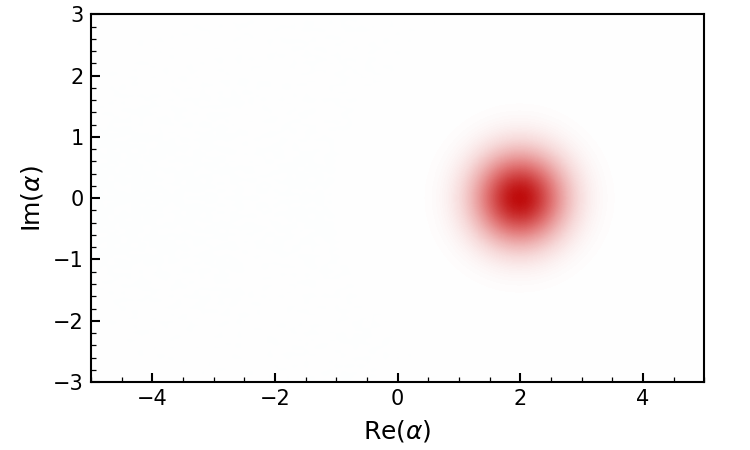

In [6]:
gif

In [7]:
n = 16
a = dq.destroy(n)
H = a.dag() @ a.dag() @ a @ a  # Kerr Hamiltonian
psi0 = dq.coherent(n, 2)
tsave = jnp.linspace(0, jnp.pi, 1001)
result = dq.sesolve(H, psi0, tsave)
gif = dq.plot.wigner_gif(result.states, gif_duration=10.0, fps=25, xmax=4.0, clear=True)

|██████████| 100.0% ◆ elapsed 99.94ms ◆ remaining 0.00ms
100%|██████████| 250/250 [00:18<00:00, 13.76it/s]


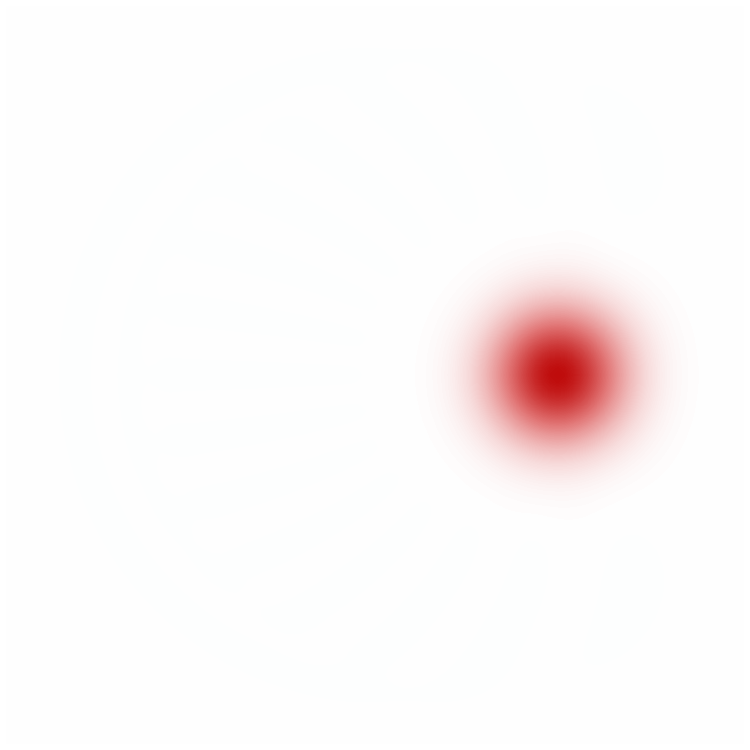

In [8]:
gif